In [92]:
import os, time, datetime
import numpy as np
import cv2
from PIL import Image
from skimage.io import imread, imsave, imshow
from scipy import ndimage as ndi
from skimage import feature
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from skimage import exposure

#'C:/Users/cvlab/Documents/GitHub/DnCNN/TrainingCodes/dncnn_keras/results/Set68/test001_dncnn.png'
#'C:/Users/cvlab/Documents/GitHub/DnCNN/TrainingCodes/dncnn_keras/data/Test/Set68/test001.png'

def show_residual(image_set, sigma):
    for i in range(1,100):
        if image_set is 'CBSD68':
            #C:\Users\nuguz\Documents\GitHub\DnCNN\results\CBSD68\noise=25
            if i>68:
                break
            path = "C:/Users/cvlab/Documents/GitHub/DnCNN/results/CBSD68/noise=" + str(sigma) + "/" + str(i)
            label_path = "C:/Users/cvlab/Documents/GitHub/DnCNN/results/CBSD68_label/" + str(i)
        
        elif image_set is 'Set12':
            if i>12:
                break
            path = "C:/Users/cvlab/Documents/GitHub/DnCNN/results/Set12/DnCNN/noise=" + str(sigma) + "/" + str(i)
            label_path = "C:/Users/cvlab/Documents/GitHub/DnCNN/results/Set12/label/" + str(i)
        
        elif image_set is 'BSD68':
            if i>68:
                break
            path = "C:/Users/cvlab/Documents/GitHub/DnCNN/results/BSD68/noise=" + str(sigma) + "/" + str(i)
            if i<10:
                label_path = "C:/Users/cvlab/Documents/GitHub/DnCNN/results/BSD68/label/test00" + str(i)
            else:
                label_path = "C:/Users/cvlab/Documents/GitHub/DnCNN/results/BSD68/label/test0" + str(i)
        
        origin = np.array(imread(label_path+'.png', dtype=np.float32))
        noise = np.array(imread(path+'_noise.png', dtype=np.float32))
        denoised = np.array(imread(path+'_dncnn.png', dtype=np.float32))
        
        structure = origin - denoised
        structure = np.clip(5 * np.clip(structure,0,255),0,255)
        #cv2.imwrite(path+'_structure.png', structure)
        
        
        residual = noise - denoised
        print(np.histogram(residual))
        mapping = interp1d([np.min(residual),20, np.max(residual)],[0,50,130])
        residual = np.clip(residual, -100, 255)
        residual = exposure.rescale_intensity(residual, in_range=(np.min(residual), np.max(residual)), out_range=(0,100))
        print(np.histogram(residual))
        residual = np.clip(2.5*residual,0,255)
        cv2.imwrite(path+'_residual.png', residual)

        #imsave('C:/Users/cvlab/Documents/GitHub/DnCNN/TrainingCodes/dncnn_keras/results/Set68/noise.png',n)

        fig = plt.figure(figsize=(15,15))
        fig.subplots_adjust(hspace=0.2, wspace=0.2)
        ax = fig.add_subplot(1,4,1)
        ax.set_title('original')
        ax.imshow(origin,interpolation='nearest',cmap='gray')

        ax = fig.add_subplot(1,4,2)
        ax.set_title('noise image')
        ax.imshow(noise,interpolation='nearest',cmap='gray')

        ax = fig.add_subplot(1,4,3)
        ax.set_title('denoised image')
        ax.imshow(denoised,interpolation='nearest',cmap='gray')

        ax = fig.add_subplot(1,4,4)
        ax.set_title('residual')
        ax.imshow(residual,interpolation='nearest',cmap='gray')
        
        print(i)
        #plt.show()
        

(array([    7,   118,  1887, 17781, 49007, 48541, 28059,  7679,  1208,
         114], dtype=int64), array([-199. , -160.5, -122. ,  -83.5,  -45. ,   -6.5,   32. ,   70.5,
        109. ,  147.5,  186. ], dtype=float32))
(array([ 4322, 18313, 34244, 40959, 30041, 17918,  6559,  1657,   337,
          51], dtype=int64), array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.],
      dtype=float32))
1
(array([   25,   419,  4154, 20677, 41284, 58472, 21136,  7054,  1120,
          60], dtype=int64), array([-200. , -161.7, -123.4,  -85.1,  -46.8,   -8.5,   29.8,   68.1,
        106.4,  144.7,  183. ], dtype=float32))
(array([ 9402, 18386, 30054, 54044, 21329, 13297,  5983,  1622,   256,
          28], dtype=int64), array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.],
      dtype=float32))
2
(array([   65,   994,  9490, 34529, 47631, 40709, 16816,  3732,   407,
          28], dtype=int64), array([-179. , -140.8, -102.6,  -64.4,  -26.2,   12. ,   50.2,   8

20
(array([   59,   766,  6517, 29183, 56256, 45572, 13159,  2588,   283,
          18], dtype=int64), array([-175. , -137.6, -100.2,  -62.8,  -25.4,   12. ,   49.4,   86.8,
        124.2,  161.6,  199. ], dtype=float32))
(array([ 4838, 15625, 42494, 41078, 34318, 11905,  3408,   633,    89,
          13], dtype=int64), array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.],
      dtype=float32))
21
(array([   42,   591,  5360, 29809, 51067, 41460, 21007,  4434,   599,
          32], dtype=int64), array([-176. , -139.2, -102.4,  -65.6,  -28.8,    8. ,   44.8,   81.6,
        118.4,  155.2,  192. ], dtype=float32))
(array([ 4604, 16468, 38722, 38451, 30985, 18347,  5314,  1295,   201,
          14], dtype=int64), array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.],
      dtype=float32))
22
(array([   29,   462,  4587, 23007, 45926, 51291, 24797,  3978,   314,
          10], dtype=int64), array([-203. , -162.9, -122.8,  -82.7,  -42.6,   -2.5,   37.6

(array([ 7570, 21834, 33283, 37859, 29290, 16712,  6465,  1156,   209,
          23], dtype=int64), array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.],
      dtype=float32))
42
(array([   42,  1032,  8754, 36806, 50188, 37610, 15630,  3828,   484,
          27], dtype=int64), array([-171. , -133.8,  -96.6,  -59.4,  -22.2,   15. ,   52.2,   89.4,
        126.6,  163.8,  201. ], dtype=float32))
(array([ 5846, 19302, 40044, 38768, 29077, 14852,  5085,  1243,   169,
          15], dtype=int64), array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.],
      dtype=float32))
43
(array([   19,   361,  3496, 19204, 48360, 47938, 29005,  5593,   405,
          20], dtype=int64), array([-203. , -163.3, -123.6,  -83.9,  -44.2,   -4.5,   35.2,   74.9,
        114.6,  154.3,  194. ], dtype=float32))
(array([ 7573, 18055, 36284, 37444, 31051, 18601,  4543,   760,    85,
           5], dtype=int64), array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90

63
(array([   49,  1295,  8512, 36135, 45990, 38836, 18829,  4321,   415,
          19], dtype=int64), array([-175. , -137.7, -100.4,  -63.1,  -25.8,   11.5,   48.8,   86.1,
        123.4,  160.7,  198. ], dtype=float32))
(array([ 7108, 21578, 35292, 37786, 29053, 16613,  5641,  1202,   120,
           8], dtype=int64), array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.],
      dtype=float32))
64
(array([   80,  1176,  7601, 25605, 63827, 36009, 15487,  4112,   463,
          41], dtype=int64), array([-166. , -129.6,  -93.2,  -56.8,  -20.4,   16. ,   52.4,   88.8,
        125.2,  161.6,  198. ], dtype=float32))
(array([ 4626, 12577, 33610, 52347, 28204, 15756,  5760,  1299,   195,
          27], dtype=int64), array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.],
      dtype=float32))
65
(array([  912,  5147, 15192, 30100, 40183, 33642, 19642,  7372,  2138,
          73], dtype=int64), array([-149. , -116.9,  -84.8,  -52.7,  -20.6,   11.5,   43.6

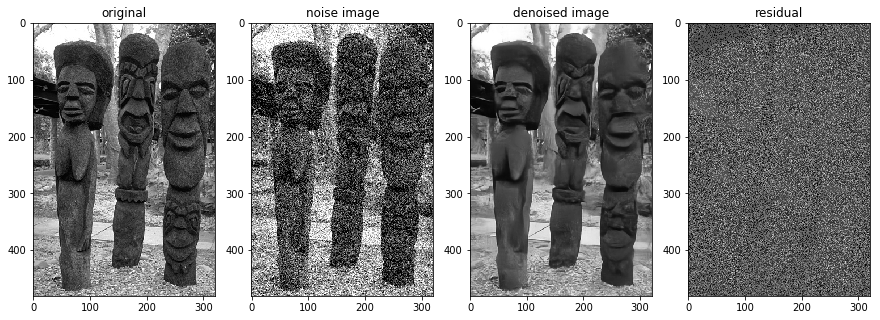

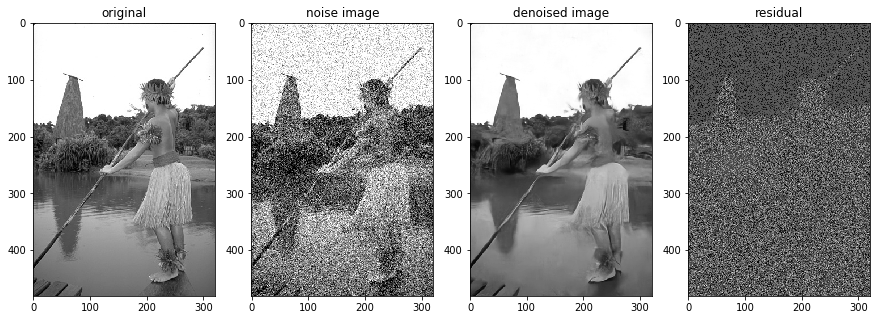

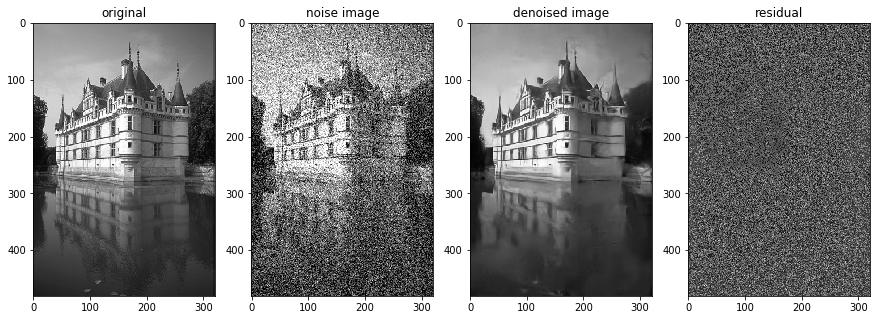

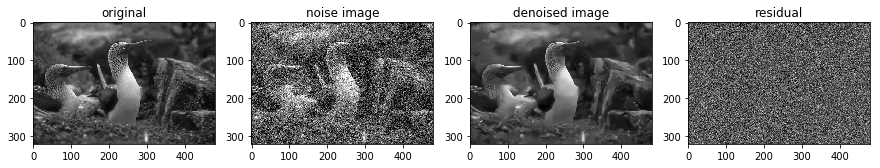

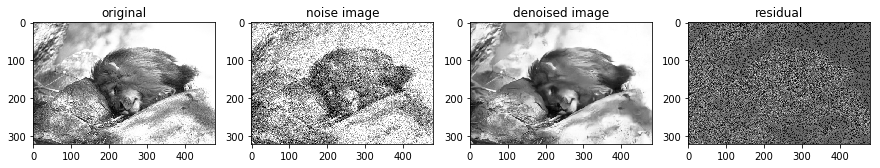

...

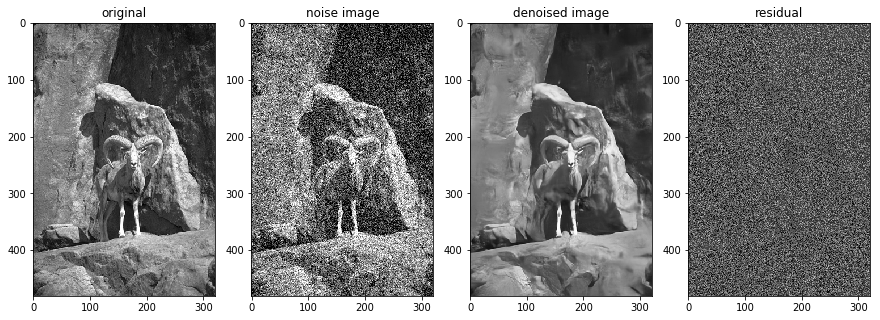

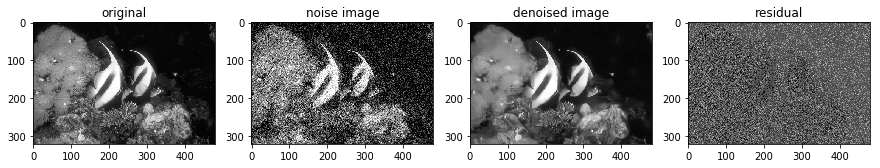

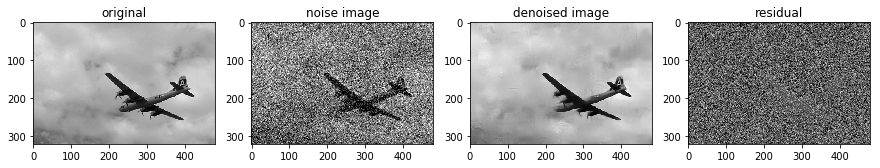

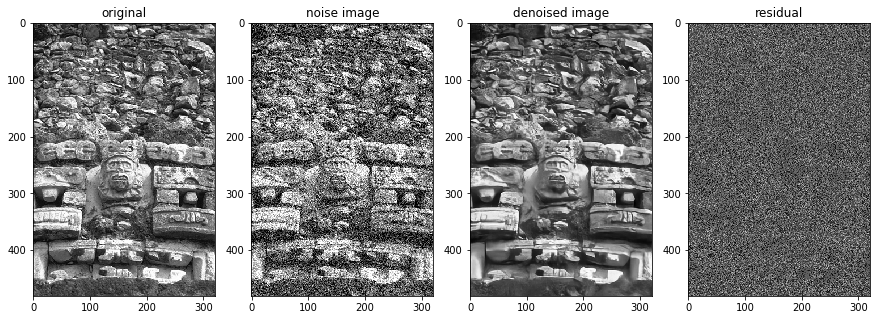

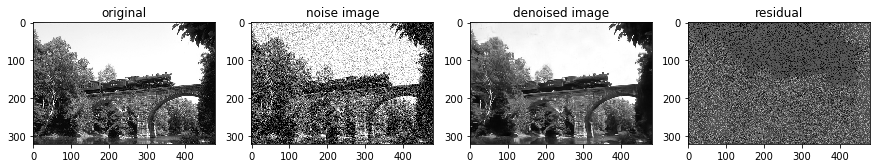

In [96]:
show_residual('BSD68', 50)